In [111]:
import sympy as sp
import numpy as np
import matplotlib.pyplot as plt
from sympy.utilities import lambdify
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


sp.init_printing()

In [112]:
x = sp.Symbol('x', real= True)
k= sp.Symbol('k', real= True, positive = True)
a = sp.Symbol('a', real= True)
m = sp.Symbol('m', real= True, positive= True)
n = sp.Symbol('n', integer = True, nonzero = True)
h = sp.Symbol('hbar', real = True, positive = True)
t = sp.Symbol('t', real = True, positive = True)
p = sp.Symbol('p', real = True)
psi = sp.Function('\psi')


a, x, k, psi(x), h, m, n, t, p 

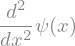

In [113]:
psi(x).diff(x, x)


In [114]:
-k**2 * psi(x)

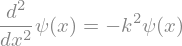

In [115]:
eq = sp.Eq(psi(x).diff(x, x), -k**2 * psi(x))
eq

In [116]:
sol = sp.dsolve(eq, psi(x), ics = {psi(0) : 0})
sol


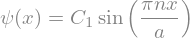

In [117]:
sol = sol.subs(k, n * sp.pi / a )
sol

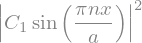

In [118]:
sp.Abs(sol.rhs)**2

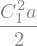

In [119]:
sp.integrate((sol.rhs)**2, (x, 0, a))

In [120]:
sol = sol.subs(sp.Symbol('C1'), sp.sqrt(2 / a))

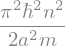

In [121]:
n**2 * sp.pi**2 * h**2 / (2 * m * a**2)

In [122]:
sp.exp(-sp.I * n**2 * sp.pi**2 * h**2 / (2 * m * a**2) * t / h)

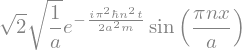

In [123]:
Psi = sol.rhs * sp.exp(-sp.I * n**2 * sp.pi**2 * h**2 / (2 * m * a**2) * t / h)
Psi

In [124]:
Psif = lambdify((x, t, n), Psi.subs({h : 1, m : 1, a : 1}))

In [125]:
Psif(0.3, 0, 1)

(1.1441228056353687+0j)

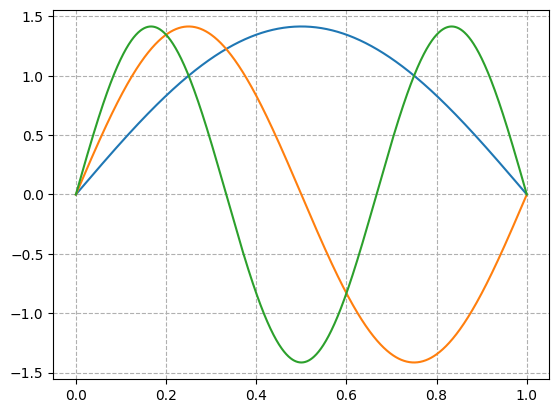

In [126]:
xs = np.linspace(0, 1, 1000)
ys = Psif(xs, 0, 1)

plt.grid(linestyle = '--')

ys = Psif(xs, 0, 1).real
plt.plot(xs, ys)

ys = Psif(xs, 0, 2).real
plt.plot(xs, ys)

ys = Psif(xs, 0, 3).real
plt.plot(xs, ys)

In [127]:
n = 3
xs = np.linspace(0, 1, 1000)

fig = plt.figure()

plt.xlim(0, 1)
plt.ylim(-1.5, 1.5)

plot1, = plt.plot([],[])
plot2, = plt.plot([],[])

plt.close()

dt = 0.01

def frame(i):
    t = i * dt
    ys = Psif(xs, t, n)
    ys1 = ys.real
    ys2 = ys.imag

    plot1.set_data(xs, ys1)
    plot2.set_data(xs, ys2)

    return plot1, plot2

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())
    

In [128]:
n = 3
xs = np.linspace(0, 1, 1000)

fig = plt.figure()

plt.xlim(0, 1)
plt.ylim(0, 4)

plot1, = plt.plot([],[])

plt.close()

dt = 0.01

def frame(i):
    t = i * dt
    ys = Psif(xs, t, 1) + Psif(xs, t, 2) / (np.sqrt(2))
    ys1 = np.abs(ys)**2


    plot1.set_data(xs, ys1)

    return plot1,

anim = FuncAnimation(fig, frame, 300, interval = 20, blit = True)
HTML(anim.to_jshtml())
    

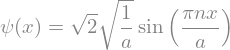

In [129]:
sol

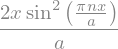

In [130]:
sol.rhs  * x  * sol.rhs

In [131]:
sp.integrate(sol.rhs  * x  * sol.rhs, (x, 0, a)).simplify()

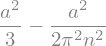

In [132]:
sp.integrate(sol.rhs  * x**2  * sol.rhs, (x, 0, a)).simplify()

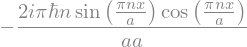

In [133]:
sol.rhs * (-sp.I * h) * sol.rhs.diff(x,1)

In [134]:
sp.integrate(sol.rhs  * (-sp.I * h)  * sol.rhs.diff(x), (x, 0, a))

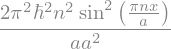

In [135]:
sol.rhs * (-sp.I * h)**2 * sol.rhs.diff(x, 2)

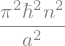

In [136]:
sp.integrate((sol.rhs * (-sp.I * h)**2 * sol.rhs.diff(x, 2)),(x, 0, a)).simplify()